In [1]:
%reload_ext autoreload
%autoreload 2
%matplotlib inline

In [31]:
import numpy as np
import pandas as pd
from pathlib import Path
import openslide
import matplotlib.pyplot as plt
import cv2
import imutils
from enum import Enum
from probreg import transformation as tf
from PIL import Image
import copy

In [3]:
from probreg import cpd
from probreg import callbacks
import open3d as o3

## Background
- https://www.learnopencv.com/homography-examples-using-opencv-python-c/
- http://www.cs.columbia.edu/~allen/F17/NOTES/homography_pka.pdf
- https://probreg.readthedocs.io/en/latest/probreg.html

In [4]:
class RegMethod(Enum):
    Homography = 0,
    Affine = 1,
        
    
def align_images(source_image, target_image, maxFeatures:int=500, 
                 keepPercent:float=0.2, debug=False, 
                 source_scale:tuple=(1,1), target_scale:tuple=(1,1)):

    source_scale = np.flip(np.array(source_scale))
    target_scale = np.flip(np.array(target_scale))
    
    # convert both the input image and template to grayscale
    imageGray = cv2.cvtColor(source_image, cv2.COLOR_BGR2GRAY)
    templateGray = cv2.cvtColor(target_image, cv2.COLOR_BGR2GRAY)
    
    # use ORB to detect keypoints and extract (binary) local
    # invariant features
    orb = cv2.ORB_create(maxFeatures)
    (kpsA, descsA) = orb.detectAndCompute(imageGray, None)
    (kpsB, descsB) = orb.detectAndCompute(templateGray, None)
    # match the features
    method = cv2.DESCRIPTOR_MATCHER_BRUTEFORCE_HAMMING
    matcher = cv2.DescriptorMatcher_create(method)
    matches = matcher.match(descsA, descsB, None)
    
    
    # sort the matches by their distance (the smaller the distance,
    # the "more similar" the features are)
    matches = sorted(matches, key=lambda x:x.distance)
    # keep only the top matches
    keep = int(len(matches) * keepPercent)
    matches = matches[:keep]
    # check to see if we should visualize the matched keypoints
    if debug:
        matchedVis = cv2.drawMatches(source_image, kpsA, target_image, kpsB,matches, None)
        matchedVis = imutils.resize(matchedVis, width=1000)
        
        fig, ax = plt.subplots(figsize=(16, 16))
        ax.imshow(matchedVis)
        plt.tight_layout()
        
        
    # allocate memory for the keypoints (x, y)-coordinates from the
    # top matches -- we'll use these coordinates to compute our
    # homography matrix
    ptsA = np.zeros((len(matches), 2), dtype="float")
    ptsB = np.zeros((len(matches), 2), dtype="float")
    # loop over the top matches
    for (i, m) in enumerate(matches):
        # indicate that the two keypoints in the respective images
        # map to each other
        ptsA[i] = kpsA[m.queryIdx].pt * source_scale 
        ptsB[i] = kpsB[m.trainIdx].pt * target_scale
        
    # compute the homography matrix between the two sets of matched
    # points
    (H, mask) = cv2.findHomography(ptsA, ptsB, method=cv2.RANSAC)

    return H, ptsA, ptsB

In [5]:
file_scanner = {
    "24_EIPH_576255 Berliner Blau.svs": {"Name": "Aperio", "slide": None, "thumbnail": None},
    "Z_BB_576255_1.tif": {"Name":"AxioScan", "slide": None, "thumbnail": None},
    "N2_BB_576255_1.ndpi": {"Name": "NanoZoomer2.0HT", "slide": None, "thumbnail": None},
    "N1_BB_576255_1.ndpi": {"Name": "NanoZoomerS210", "slide": None, "thumbnail": None},
}

In [6]:
df = pd.read_pickle("reg_results.p")

df["center_x"] = [x1 + ((x2-x1) / 2) for x1, x2 in zip(df["x1"], df["x2"])]
df["center_y"] = [y1 + ((y2-y1) / 2) for y1, y2 in zip(df["y1"], df["y2"])]

df["scanner"] = [file_scanner[file]["Name"] for file in df["file"]]

df.head()

,file,scanner,image_nr,width,height,x1,y1,x2,y2,label,score,center_x,center_y
0,24_EIPH_576255 Berliner Blau.svs,Aperio,576255,34200,32356,10978.0,7036.0,11107.0,7166.0,4.0,0.929032,11042.5,7101.0
1,24_EIPH_576255 Berliner Blau.svs,Aperio,576255,34200,32356,30033.0,13813.0,30201.0,13981.0,2.0,0.926395,30117.0,13897.0
2,24_EIPH_576255 Berliner Blau.svs,Aperio,576255,34200,32356,18278.0,4283.0,18394.0,4399.0,1.0,0.926342,18336.0,4341.0
3,24_EIPH_576255 Berliner Blau.svs,Aperio,576255,34200,32356,25220.0,11058.0,25328.0,11167.0,1.0,0.925790,25274.0,11112.5
4,24_EIPH_576255 Berliner Blau.svs,Aperio,576255,34200,32356,12767.0,22738.0,12885.0,22856.0,1.0,0.922600,12826.0,22797.0


In [11]:
def get_region_thumbnail(slide, size=(2048, 2048)):
    
    scale = []

    downsample = max(*[dim / thumb for dim, thumb in zip(slide.dimensions, size)])        
    level = slide.get_best_level_for_downsample(downsample)

    downsample = slide.level_downsamples[level]
    scale.append(np.array((downsample, downsample)))

    tile = slide.read_region((0, 0), level, slide.level_dimensions[level])

    thumb = Image.new('RGB', tile.size, '#ffffff')
    thumb.paste(tile, None, tile)
    thumb.thumbnail(size, Image.ANTIALIAS)
    
    scale.append(np.array(tile.size) /  thumb.size)
    
    return thumb, scale

Wall time: 6.26 s


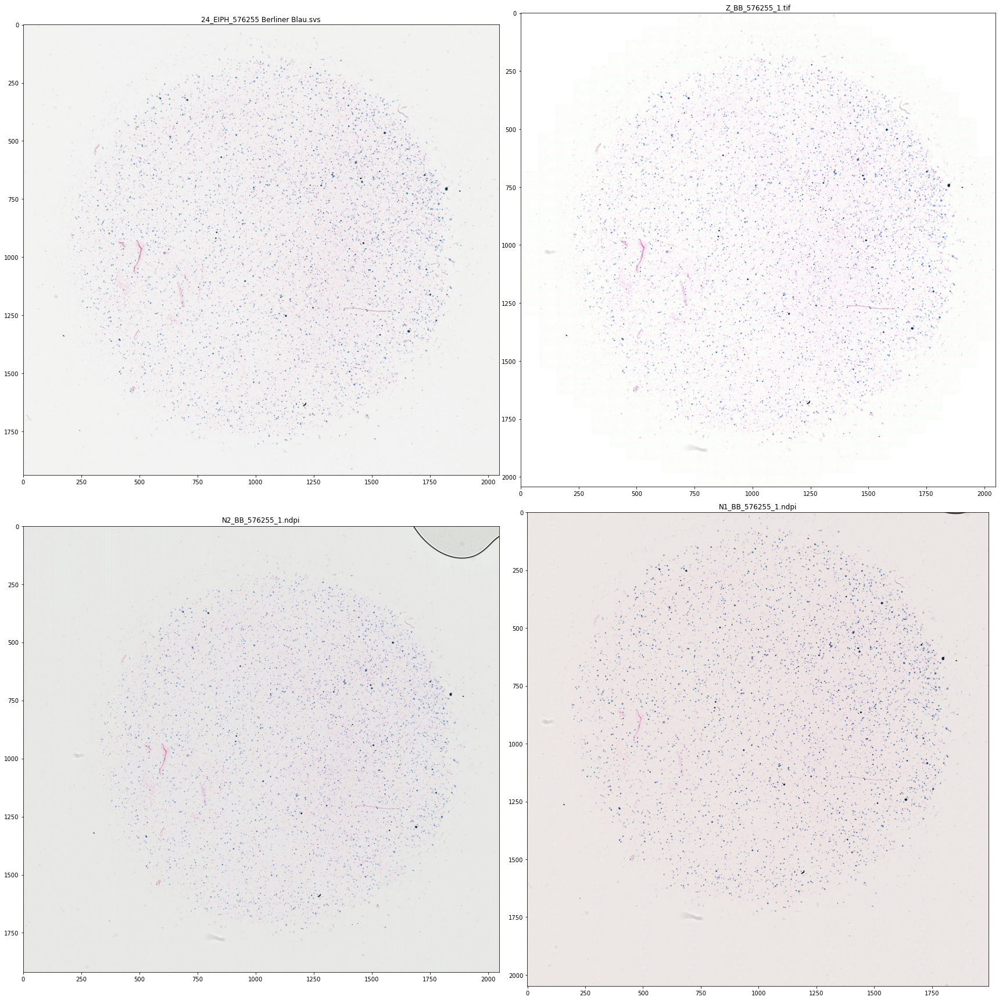

In [79]:
%%time

f, axarr = plt.subplots(2,2,figsize=(24,24))

for id, path in enumerate(df["file"].unique()):
    
    slide = openslide.OpenSlide(filename=f'../Slides/{file_scanner[path]["Name"]}/{path}')
    file_scanner[path]["slide"] = slide
    
    thumbnail, scale = get_region_thumbnail(slide, size=(2048, 2048))
    
    file_scanner[path]["scale"] = scale

    file_scanner[path]["thumbnail"] = thumbnail
        
    if id == 0: axarr[0,0].imshow(thumbnail); axarr[0,0].set_title(path)
    if id == 1: axarr[0,1].imshow(thumbnail); axarr[0,1].set_title(path)
    if id == 2: axarr[1,0].imshow(thumbnail); axarr[1,0].set_title(path)
    if id == 3: axarr[1,1].imshow(thumbnail); axarr[1,1].set_title(path)    
        
plt.tight_layout()

Wall time: 1.38 s


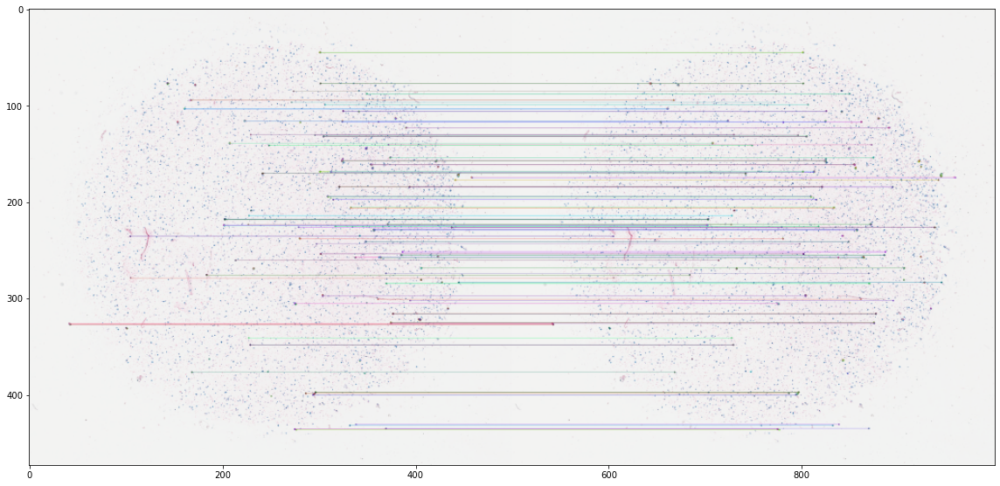

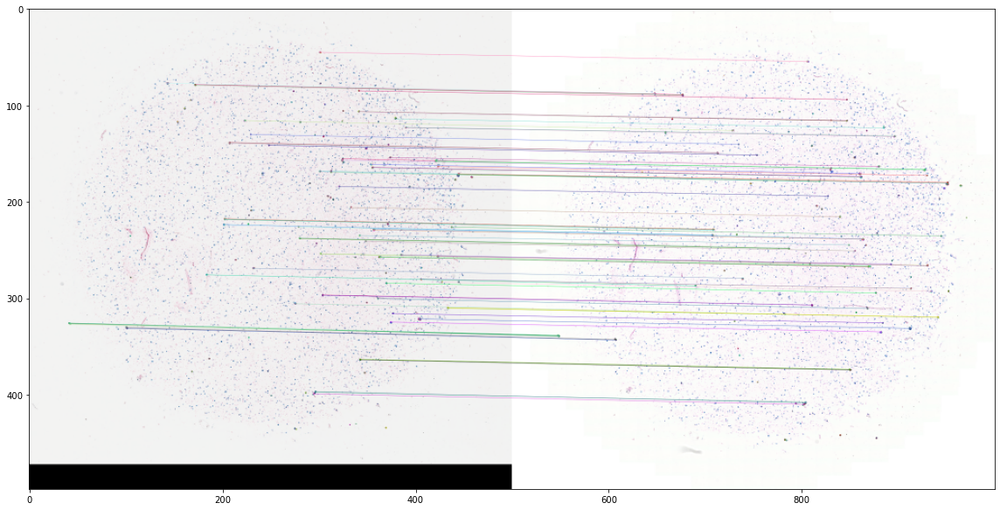

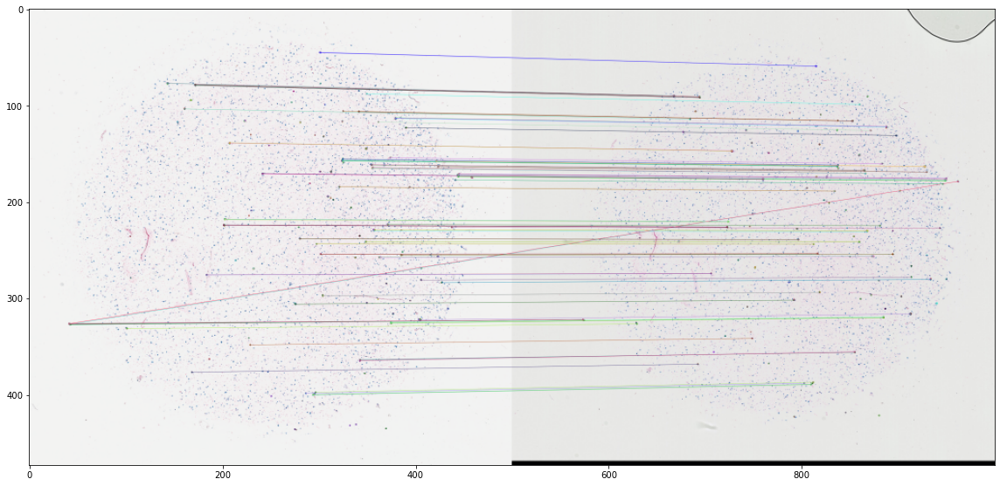

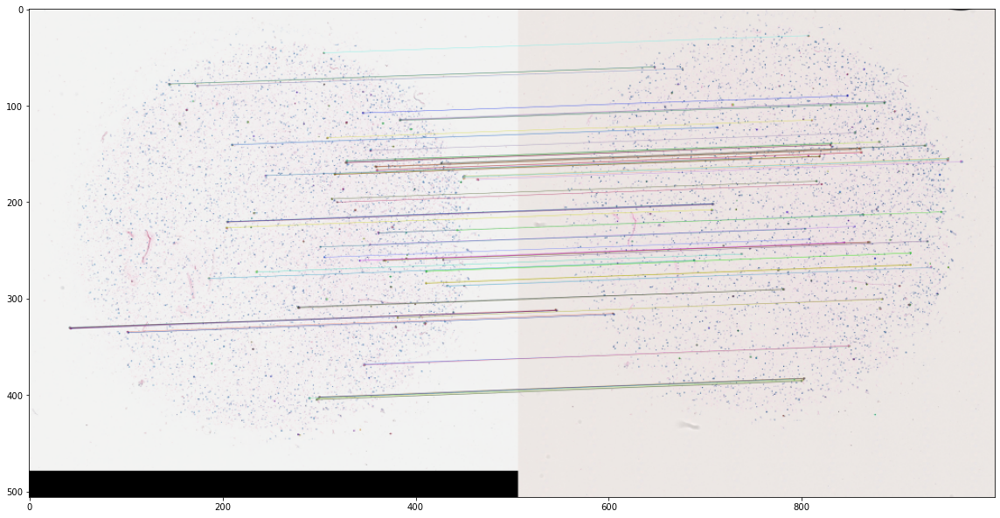

In [78]:
%%time

source_file = "24_EIPH_576255 Berliner Blau.svs"
source_image = np.array(file_scanner[source_file]["thumbnail"])
source_scale = file_scanner[source_file]["scale"]

for path in df["file"].unique():
    target_image = np.array(file_scanner[path]["thumbnail"])
    target_scale = file_scanner[path]["scale"]
    
    #H, ptsA, ptsB = align_images(source_image, target_image, source_scale=source_scale, target_scale=target_scale, debug=True)
    H, ptsA, ptsB = align_images(source_image, target_image, debug=True)
    tf_param, _, _ = cpd.registration_cpd(ptsA, ptsB, 'affine')
    
    file_scanner[path]["Homography"] = H
    file_scanner[path]["ptsA"] = ptsA
    file_scanner[path]["ptsB"] = ptsB
    file_scanner[path]["tf_b"] = tf_param.b
    file_scanner[path]["tf_t"] = tf_param.t

In [82]:
source_file = "24_EIPH_576255 Berliner Blau.svs"
source_slide = file_scanner[source_file]["slide"]

x_source, y_source = 768, 768

## Homography Transform

### WSI

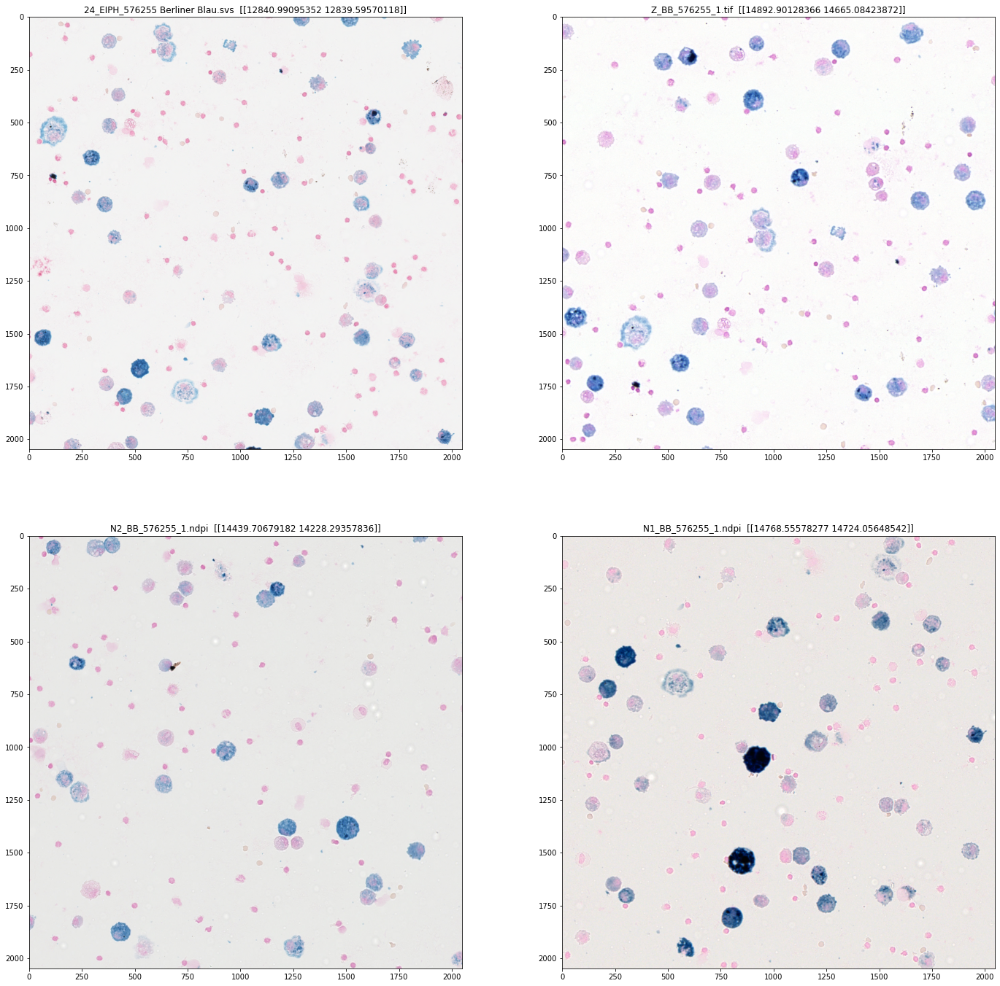

In [83]:
f, axarr = plt.subplots(2,2,figsize=(24,24))

for id, path in enumerate(df["file"].unique()):
    
    H = file_scanner[path]["Homography"]    
    tf_temp = tf.AffineTransformation(H[:2,:2], H[2:,2:])
    
    transformed = tf_temp.transform(np.array([x_source, y_source]))
    
    for scale in file_scanner[path]["scale"]:
        transformed *= scale
    
    target_slide = file_scanner[path]["slide"]
    
    image_target = target_slide.read_region(location=(transformed[0].astype(int)), level=0, size=(2048, 2048))

    if id == 0: axarr[0,0].imshow(image_target); axarr[0,0].set_title(f'{path}  {transformed}')
    if id == 1: axarr[0,1].imshow(image_target); axarr[0,1].set_title(f'{path}  {transformed}')
    if id == 2: axarr[1,0].imshow(image_target); axarr[1,0].set_title(f'{path}  {transformed}')
    if id == 3: axarr[1,1].imshow(image_target); axarr[1,1].set_title(f'{path}  {transformed}')

## ICP

### WSI

In [72]:
for id, path in enumerate(df["file"].unique()):
    
    
    tf_b = file_scanner[path]["tf_b"]    
    tf_t = file_scanner[path]["tf_t"]    
    tf_temp = tf.AffineTransformation(tf_b, tf_t)
    
    transformed_a = tf_temp.transform(np.array([768, 768]))
    transformed_b = tf_temp.transform(np.array([1024, 1024]))
    
    for scale in file_scanner[path]["scale"]:
        transformed_a *= scale
        transformed_b *= scale
    
    print(f'{path}: \n {file_scanner[path]["tf_b"]} \n A: {transformed_a} \n B: {transformed_b} \n')

24_EIPH_576255 Berliner Blau.svs: 
 [[ 1.00000000e+00 -3.23982214e-16]
 [-2.93712960e-17  1.00000000e+00]] 
 A: [12824.29265579 12822.89921782] 
 B: [17099.05687438 17097.19895709] 

Z_BB_576255_1.tif: 
 [[ 1.00424997  0.00756353]
 [-0.00763717  1.00407179]] 
 A: [15088.59291371 15522.96255246] 
 B: [20036.10861449 20394.84144225] 

N2_BB_576255_1.ndpi: 
 [[ 0.93870998  0.00419833]
 [-0.00376382  0.92947845]] 
 A: [17111.75636405 15742.61559079] 
 B: [21939.44691927 20482.27450091] 

N1_BB_576255_1.ndpi: 
 [[ 0.99573407  0.00108522]
 [-0.00191559  0.99523216]] 
 A: [14443.30287956 13361.91924992] 
 B: [19355.14863611 18256.98329909] 



In [68]:
mpp_x_source = float(source_slide.properties.get(openslide.PROPERTY_NAME_MPP_X, np.NaN))
mpp_y_source = float(source_slide.properties.get(openslide.PROPERTY_NAME_MPP_Y, np.NaN))

for id, path in enumerate(df["file"].unique()):
    
    slide = file_scanner[path]["slide"]
    mpp_x_target = float(slide.properties.get(openslide.PROPERTY_NAME_MPP_X, 0.221))
    mpp_y_target = float(slide.properties.get(openslide.PROPERTY_NAME_MPP_Y, 0.221))
    
    mpp_x_scale, mpp_y_scale = None, None
    if np.isnan(mpp_x_target) == False and np.isnan(mpp_y_target) == False:
        mpp_x_scale = mpp_x_source / mpp_x_target
        mpp_y_scale = mpp_y_source / mpp_y_target
    
    print(f'{path}: X: {mpp_x_target} Y: {mpp_y_target}  XS: {mpp_x_scale} YS: {mpp_y_scale}')

24_EIPH_576255 Berliner Blau.svs: X: 0.2533 Y: 0.2533  XS: 1.0 YS: 1.0
Z_BB_576255_1.tif: X: 0.221 Y: 0.221  XS: 1.1461538461538463 YS: 1.1461538461538463
N2_BB_576255_1.ndpi: X: 0.22632114971144054 Y: 0.22753128555176336  XS: 1.11920605 YS: 1.1132535000000001
N1_BB_576255_1.ndpi: X: 0.2206287920573635 Y: 0.2206287920573635  XS: 1.14808225 YS: 1.14808225


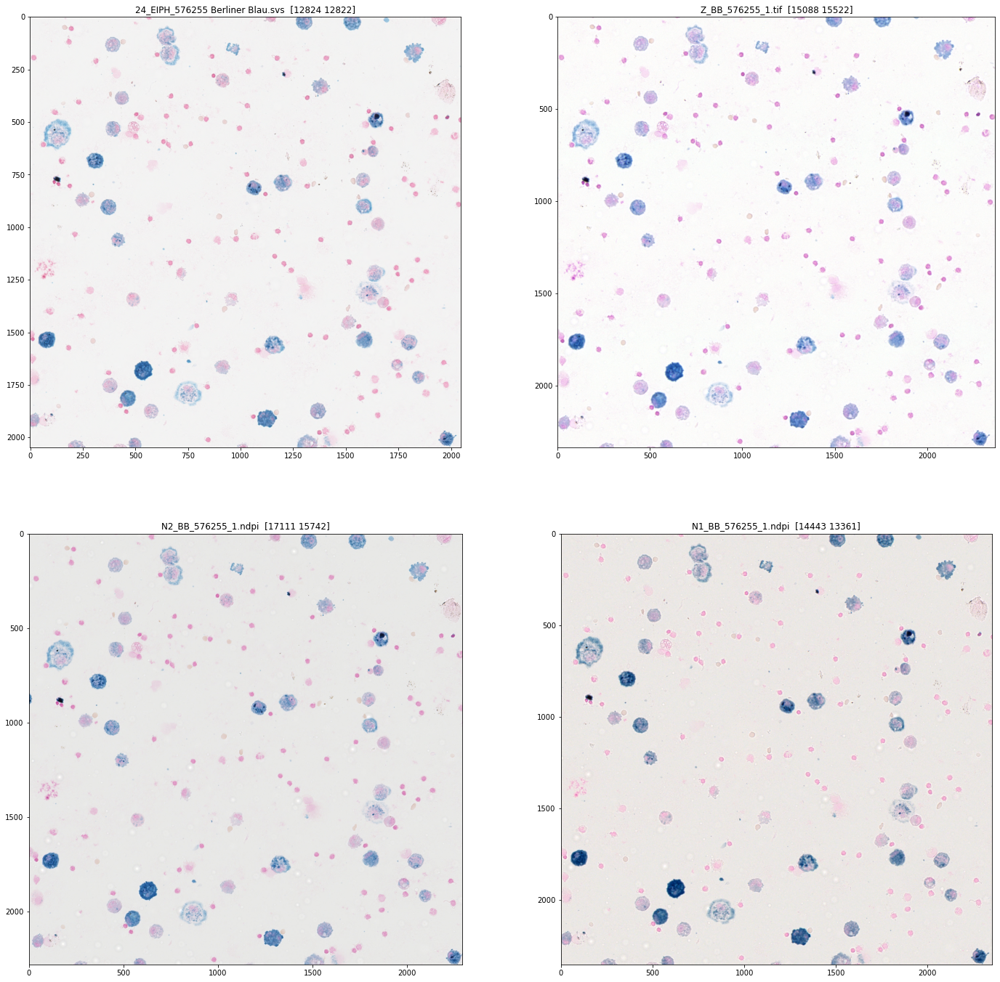

In [73]:
mpp_x_source = float(source_slide.properties.get(openslide.PROPERTY_NAME_MPP_X, np.NaN))
mpp_y_source = float(source_slide.properties.get(openslide.PROPERTY_NAME_MPP_Y, np.NaN))

f, axarr = plt.subplots(2,2,figsize=(24,24))

for id, path in enumerate(df["file"].unique()):
    patch_width, patch_height = 2048, 2048
    target_slide = file_scanner[path]["slide"]
    
    tf_b = file_scanner[path]["tf_b"]    
    tf_t = file_scanner[path]["tf_t"]    
    tf_temp = tf.AffineTransformation(tf_b, tf_t)
    
    mpp_x_scale, mpp_y_scale = None, None
    mpp_x_target = float(target_slide.properties.get(openslide.PROPERTY_NAME_MPP_X, np.NaN)) #np.NaN
    mpp_y_target = float(target_slide.properties.get(openslide.PROPERTY_NAME_MPP_Y, np.NaN)) #np.NaN
    if np.isnan(mpp_x_target) == False and np.isnan(mpp_y_target) == False:
        mpp_x_scale = mpp_x_source / mpp_x_target
        mpp_y_scale = mpp_y_source / mpp_y_target
        
        patch_width, patch_height = int(patch_width * mpp_x_scale), int(patch_height * mpp_y_scale)
        
    else:
        patch_width, patch_height = int(patch_width * 1.157377448), int(patch_height * 1.139807498)
        #patch_width, patch_height = int(patch_width + patch_width * (1 - tf_b[0][0])), int(patch_height + patch_height * (1 - tf_b[1][1]))
    
    transformed = tf_temp.transform(np.array([768, 768]))
    
    for scale in file_scanner[path]["scale"]:
        transformed *= scale
    transformed = transformed.astype(int)
    
    
    image_target = target_slide.read_region(location=(transformed), level=0, size=(patch_width, patch_height))

    if id == 0: axarr[0,0].imshow(image_target); axarr[0,0].set_title(f'{path}  {transformed}')
    if id == 1: axarr[0,1].imshow(image_target); axarr[0,1].set_title(f'{path}  {transformed}')
    if id == 2: axarr[1,0].imshow(image_target); axarr[1,0].set_title(f'{path}  {transformed}')
    if id == 3: axarr[1,1].imshow(image_target); axarr[1,1].set_title(f'{path}  {transformed}')

## Feature Points WSI

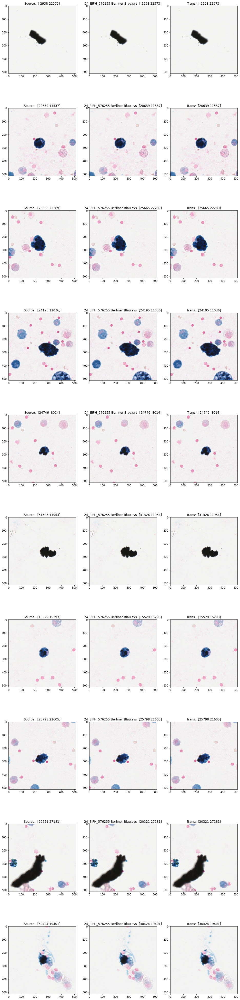

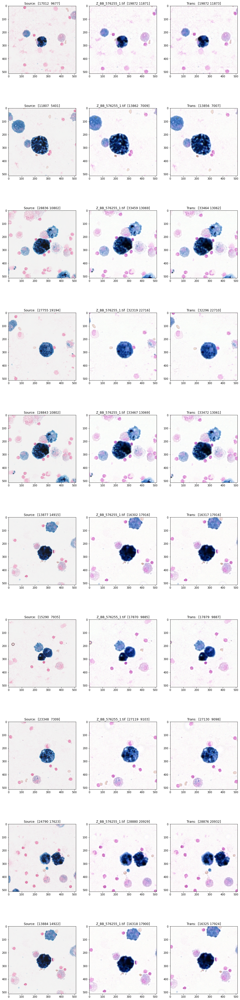

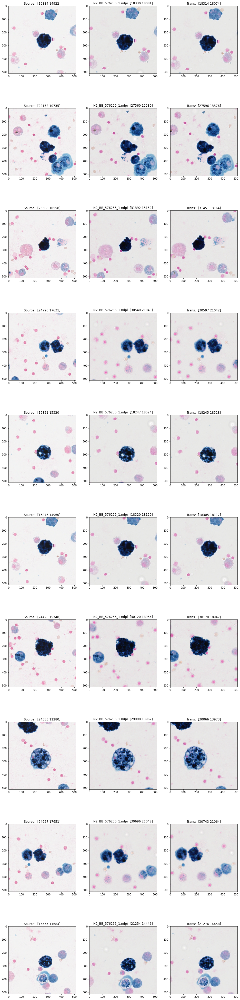

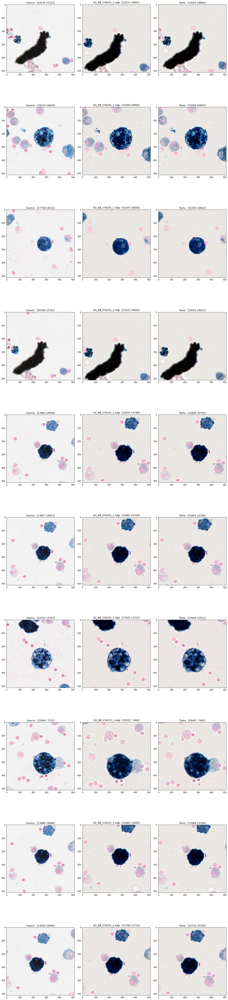

In [35]:
num_patches = 10
size = 512

for id, path in enumerate(df["file"].unique()):
    
    f, axarr = plt.subplots(num_patches, 3, figsize=(16, 72))
        
    target_slide = file_scanner[path]["slide"]    
    
    ptsA = file_scanner[path]["ptsA"].copy()
    ptsB = file_scanner[path]["ptsB"].copy()
    
    tf_b = file_scanner[path]["tf_b"]    
    tf_t = file_scanner[path]["tf_t"]    
    tf_temp = tf.AffineTransformation(tf_b, tf_t)
       
    
    for idx, (pA, pB) in enumerate(zip(ptsA, ptsB)):
        
        transformed = tf_temp.transform(pA.copy())
        for scale in file_scanner[path]["scale"]:
            transformed *= scale
                
        for scale in file_scanner[source_file]["scale"]:
            pA *= scale
            
        for scale in file_scanner[path]["scale"]:
            pB *= scale
        
        pA = pA.astype(int)
        pB = pB.astype(int)
        transformed = transformed.astype(int)
    
        image_source = source_slide.read_region(location=pA.astype(int) - (size // 2, size // 2), 
                                                level=0, size=(size, size))
        image_target = target_slide.read_region(location=pB.astype(int) - (size // 2, size // 2), 
                                                level=0, size=(size, size))
        image_target_trans = target_slide.read_region(location=transformed - (size // 2, size // 2), 
                                                level=0, size=(size, size))
            
    
        axarr[idx,0].set_title(f'Source:  {pA}')
        axarr[idx,1].set_title(f'{path}  {pB}')
        axarr[idx,2].set_title(f'Trans:  {transformed}')
        
        axarr[idx,0].imshow(image_source)
        axarr[idx,1].imshow(image_target)
        axarr[idx,2].imshow(image_target_trans)
        
        if num_patches-1 == idx:
            break

plt.tight_layout()    